<a href="https://colab.research.google.com/github/gadm21/satellite-imagery-analysis/blob/main/Unsupervised%20learning/Unsupervised_learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Import

In [ ]:
import numpy as np
from sklearn import cluster 
from osgeo import gdal, gdal_array 
import os 
import matplotlib.pyplot as plt
import cv2
from skimage import exposure
#import geopandas as gpd
from PIL import Image

from google.colab.patches import cv2_imshow

## Functions

In [ ]:


def download_bands():
  !wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies \
   --no-check-certificate 'https://docs.google.com/uc?export=download&id=1UDFDa-UIZhvtjEZeGv2HMb5mmofn87DT' \
   -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1UDFDa-UIZhvtjEZeGv2HMb5mmofn87DT" -O udm2_band1.jpg && rm -rf /tmp/cookies.txt


  !wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies \
   --no-check-certificate 'https://docs.google.com/uc?export=download&id=1wTYk9_mYMN5xvdyxhCl91wJghSfrxt03' \
   -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1wTYk9_mYMN5xvdyxhCl91wJghSfrxt03" -O zayed.jpg && rm -rf /tmp/cookies.txt

  !wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies \
   --no-check-certificate 'https://docs.google.com/uc?export=download&id=1hz53V3UDJPu01hDHufWMpxOpqgSivol6' \
   -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1hz53V3UDJPu01hDHufWMpxOpqgSivol6" -O zayed_labeled.png && rm -rf /tmp/cookies.txt

def read_image(path):
  return cv2.imread(path) 

def kmean_cluster(band, n_clusters = 5):
    X = band.reshape((-1, 1))

    kmeans = cluster.KMeans(n_clusters=n_clusters ) 
    kmeans.fit(X) 

    return kmeans.labels_.reshape((band.shape))

def composite(bands, to_rgb=False):
    
    rgb = np.array(bands)
    rgb = np.moveaxis(rgb, 0, -1) 
    if to_rgb : rgb = rgb = ((rgb.astype(np.float32) / np.max(rgb) )*255).astype(np.uint8)
    
    return rgb

def resize_image(image, newsize):
    ratio = newsize / image.shape[0] 
    return cv2.resize(image, (int(ratio*image.shape[1]), newsize))

def find_red_color_in_image(image, binary = False):
  image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV) 
  
  lower_red = np.array([170,50,50])
  upper_red = np.array([180,255,255])
  mask = cv2.inRange(image_hsv, lower_red, upper_red)
  
  return mask

def count_values(value, values):
  count = 0 
  for v in list(values) : 
    if np.array_equal(value, v) : 
      count += 1
  return count

In [ ]:
%%capture
download_bands()

## Play

### The satellite imagery I am working on is a 4-band multispectral orthorectified acquired by **PlanetScope** and downloaded from [Planet.com](https://planet.com). 

### The four bands of the image are:

1.   Band 1 = Blue
2.   Band 2 = Green
3.   Band 3 = Red
4.   Band 4 = Near-infrared


### compositing the color bands in an RGB image yeilds a natural view of earth. 

### NOTE: I resize all images, while keeping aspect ratio, to make processing possible for this huge image.

In [ ]:
newsize = 2000 #resize (down from 3736), while keeping the aspect ratio of the image to make processing faster, and possible.

size of image before resizing: (3736, 7863, 3)
size of image after resizing: (2000, 4209, 3)


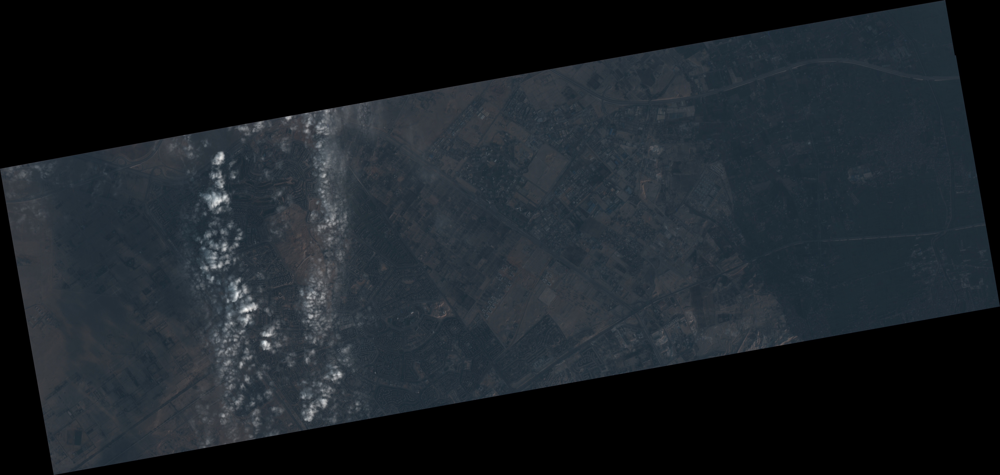

In [ ]:
zayed = read_image('zayed.jpg')
print("size of image before resizing:", zayed.shape)
zayed = resize_image(zayed, newsize)  
print("size of image after resizing:", zayed.shape)
cv2_imshow(zayed) 


### Alongside with the image, there are the usable data masks (UDM). PlanetScope has two versions of it: UDM (1-band mask) and UDM2 (8-band mask). the 8th band of UDM2 is equivalent to UDM.

### The 8 bands of UDM2 are:

1.   Band 1 = clear map
2.   Band 2 = snow map
3.   Band 3 = shadow map
4.   Band 4 = light haze map
4.   Band 5 = heavy haze map
4.   Band 6 = cloud map
4.   Band 7 = confidence map
4.   Band 8 = unusable pixels


### For simplicity, I'll only consider the 1st UMD2 band becuase it almost includes all other bands, since I only care about clear vs unclear pixels.


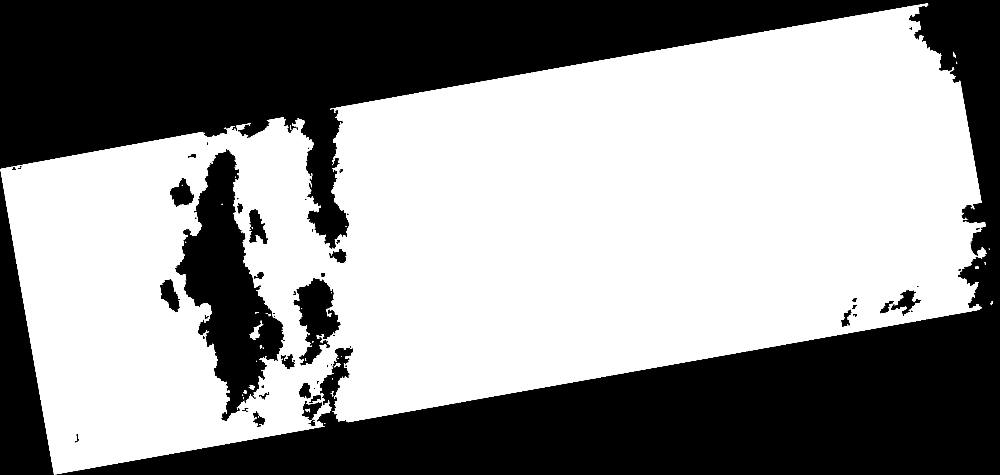

In [ ]:
udm2_band1 = read_image('udm2_band1.jpg') 
udm2_band1 = resize_image(udm2_band1, newsize)
cv2_imshow(udm2_band1) 

### Applying the UDM2 Band1 mask on the image to process only clear pixels.

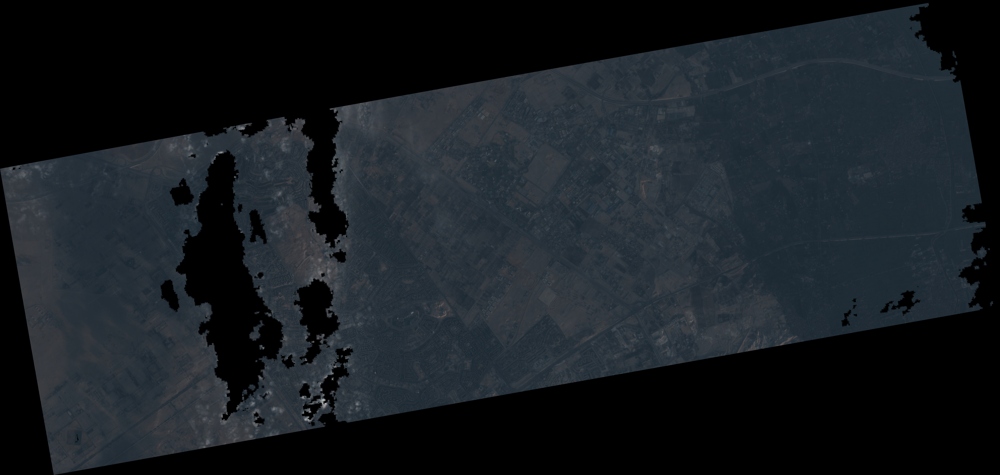

In [ ]:
clear_zayed_city = zayed.copy()
clear_zayed_city[udm2_band1==0] = 0

cv2_imshow(clear_zayed_city)

### to make the image clearer for inspection, I apply histogram equalization. However, kmean and training the CNN model will not use the equalized image because distribution of brightness changes from what we naturally get from satellites. Its only for clearer inspection.

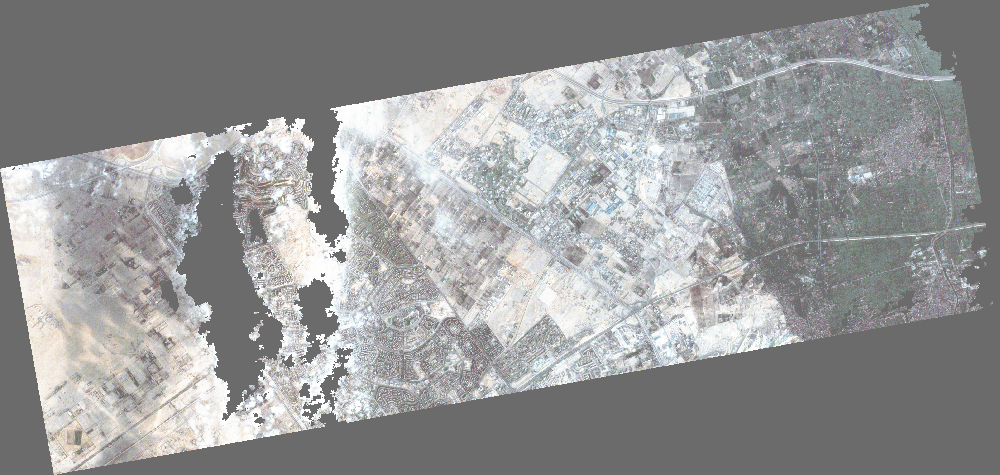

In [ ]:
equ_zayed_city = [exposure.equalize_hist(band) for band in list(np.moveaxis(clear_zayed_city, -1, 0))]
equ_zayed_city = composite(equ_zayed_city, to_rgb = True) 

cv2_imshow(equ_zayed_city)

## Unsupervised learning. Applying kmeans on the 3-band rgb image use the resulting labels in supervised deep learning models training later on.


### NOTES:
1. we can apply kmean on all the 4 bands, instead of 3 bands. But this is in the parallel universe which has better internet capacity to upload the tif file instead of the rgb image or/and more local resources to perform this operation locally.

2. kmean requires specifiying the number of clusters. Ideally, If we think there are 4 objects of interest we want to cluster them, we choose a k>4. Maybe k=10. However, due to limitations on RAM and computing, k (number of clusters) is lower than what it should have been.

3. resizing the image was also meant to make processing faster and enable me to use expensive algorithms like kmean clustering easier.

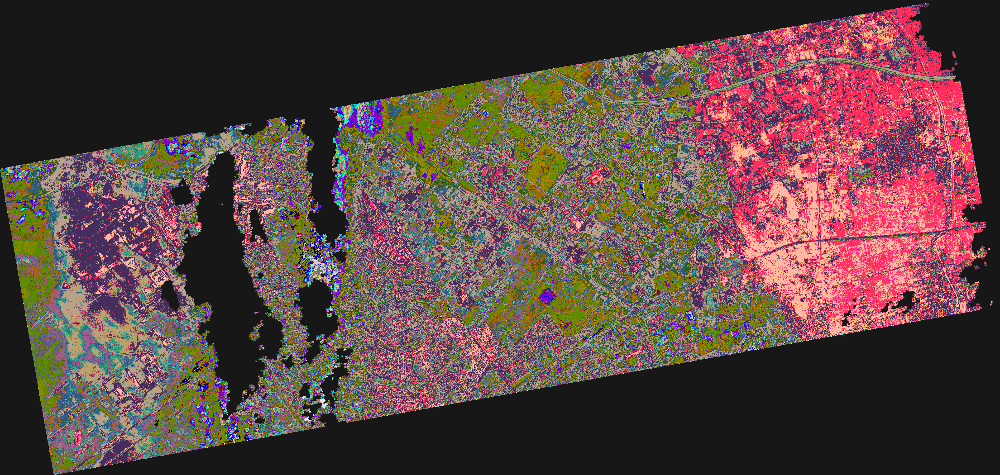

In [ ]:
clustered_image2 = kmean_cluster(clear_zayed_city, n_clusters = 12)
clustered_image2 = np.array(clustered_image2 * (255 / np.max(clustered_image2)), dtype = np.uint8)

cv2_imshow(clustered_image2) 



---



---

---

---






---


---

---





## clustering is an unsupervised learning, which implies that the clusters it obtains doesn't completelly align with the classes we want to separate (urban, farm, ...). To solve this issue, I will download the original image and, manually, I will identify some instances of a certain class, then I will mask the clustered image with the manually identified regions. The colors of the clustered image which are assigned to the manually identified regions are considered the true labels for that class. 

## The following images shows this approach applied on urban areas

## The red dots in the following image are manually labeled on urban areas

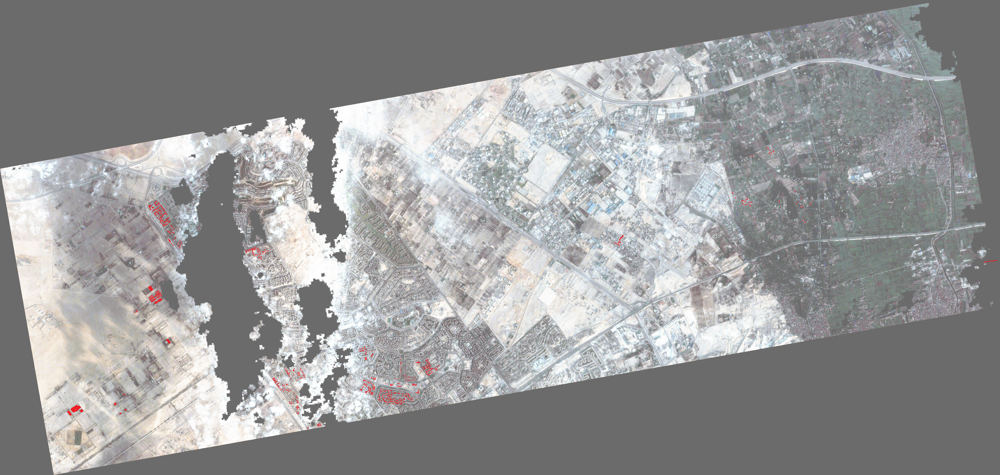

In [ ]:
zayed_labeled =  read_image('zayed_labeled.png') 
cv2_imshow(zayed_labeled)

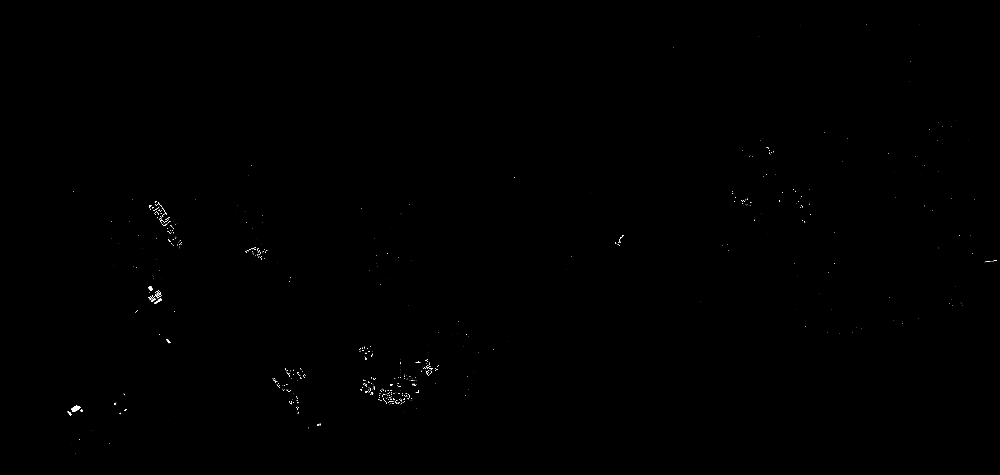

In [ ]:
red_dots_mask = find_red_color_in_image(zayed_labeled)
cv2_imshow(red_dots_mask)

In [ ]:
urban_clustered_values = clustered_image2[np.where(red_dots_mask)]
unique_ucv = list(np.unique(urban_clustered_values, axis=0))
freq = [(count_values(value, urban_clustered_values), value) for value in unique_ucv] 
freq.sort(key = lambda x: x[0], reverse=True) 

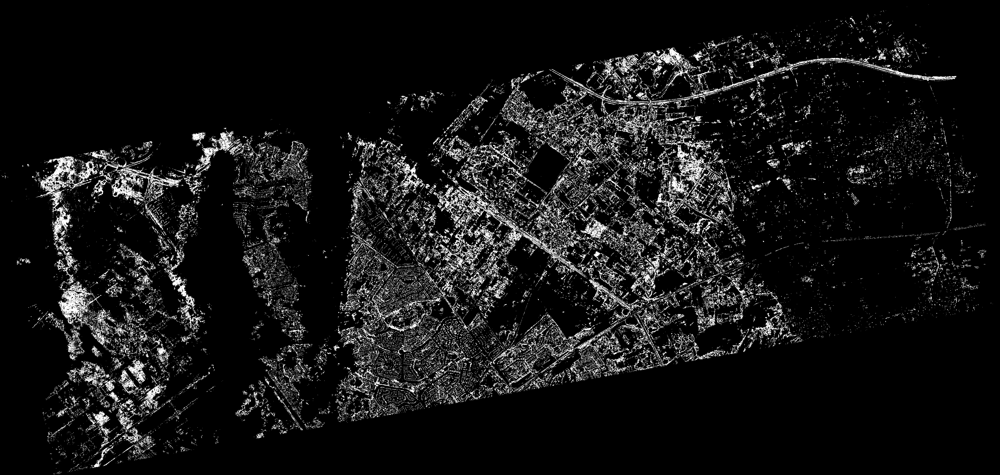

In [ ]:
urban_mask = np.zeros((zayed.shape[0], zayed.shape[1], 1), dtype=np.uint8)
for f in range(1):
  urban_mask[(clustered_image2==freq[f][1]).all(axis=2)] = 255
cv2_imshow(urban_mask)

## The previous mask shows the urban areas in the image.


# Notes


1.   Although hourses and roads are very clear in the urban mask, there are some problems which can be fixed by choosing higher k in kmean clustering as well as more accurate manuall labeling.
2.   This mask is the final output from the **unsupervised learning** step. I should do the same steps to get another mask for agriculture areas, but this will be enough for illustration purposes. This mask will be used in the following **supervised learning** notebook to train the SegNet model to detect urban areas.





---



---

---

---






---


---

---





In [ ]:
save_path = '/content/drive/MyDrive/satellite/zayed'
cv2.imwrite(os.path.join(save_path, 'urban_mask.jpg'), urban_mask) 

True

# to be continued ...